---
draft: true
---

# Part 2

**Testing and Refining Custom Functions**

In [4]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
# import required libraries
import numpy as np
import pandas as pd
import os
from fastai.vision.all import*
from fastai.metrics import error_rate, accuracy
#import function for creating data batches
from fastai.vision.data import ImageDataLoaders

#turn off Fast Ai warning that doesn't affect anything
import warnings
warnings.filterwarnings('ignore')
#for saving and loading model states
import torch

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/README.md
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/labels.csv
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/B00015.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/F00360.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/I00157.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/J00075.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/H00005.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/I00385.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/F00050.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/I00300.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/I00325.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/W00103.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/J00073.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/H00344.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/G00315.jpg
/kaggle/input/bee-vs-wasp/kaggle_bee_vs_wasp/wasp2/I00436.jpg
/kaggle/input/bee-vs-

Bring over my custom model training function.

In [13]:
#| label: custom-trainmodels
#Function to train models more easily
def train_models(image_size, batch_size, images_path, test_size, model_type):
    #instructions for preparing data batches, size of images
    #and normalize data
    batch_tfms = [*aug_transforms(size=image_size),Normalize.from_stats(*imagenet_stats)]

    #function for creating batches with specified parameters
    data = ImageDataLoaders.from_folder(images_path,
                                        valid_pct=test_size,
                                        ds_tfms=batch_tfms,
                                        item_tfms=Resize(460),
                                        bs=batch_size)
    
    # test whether batch function is working with parameters
    data.show_batch(max_n=9, figsize=(20,10))

    #return the trained model
    return vision_learner(data, model_type, metrics=error_rate).to_fp16()

In [14]:
#Image path
images_path = "/kaggle/working/images"

# created labels of classes from folder directories
labels = os.listdir(images_path)
print("No. of labels: {}".format(len(labels)))
print("-----------------")

#display dataset size, detailing how many photos there are for each class
for label in labels:
  print("{}, {} files".format(label, len(os.listdir(images_path+'/'+label))))

No. of labels: 6
-----------------
bee2, 714 files
other_noinsect, 856 files
wasp1, 2127 files
bee1, 2469 files
other_insect, 2439 files
wasp2, 2816 files


Edit functions to use with kaggle kernel and alter optimization_study function so that I can add another custom function that uses it.

In [14]:
#function to tune automate tuning
def tune_hyperparameters(trial, image_size, images_path, test_size, model_type):
    # Define the hyperparameters to tune
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 1e-1)
    batch_size = trial.suggest_categorical("batch_size", [16, 32, 64])
    weight_decay = trial.suggest_loguniform("weight_decay", 1e-5, 1e-3)

    #Create model with dataset and parameters
    learn = train_models(image_size, batch_size, images_path, test_size, model_type)

    # Define the hyperparameters of the fastai learner
    learn.lr_find()

    # Fit the model with the hyperparameters
    learn.fine_tune(1, base_lr=learning_rate, wd=weight_decay)

    # Evaluate the model on the validation set
    error_rate = learn.validate()[1]
    
    # Specify the directory and file name for saving the state dictionary
    #directory = "/kaggle/working/"
    filename =f"/kaggle/working/{model_type.__name__}_state_dict_trial_{trial.number}.pth" 

    # Create the directory if it does not exist
    #os.makedirs(directory, exist_ok=True)

    # Combine the directory and filename to create the complete file path
    model_state_dict_file = filename #os.path.join(directory, filename)

    # Save the model's state dictionary
    torch.save(learn.model.state_dict(), model_state_dict_file)

    return error_rate

def optimization_study(image_size, images_path, test_size, selected_model, trial_size):

    # Create an Optuna study and optimize the tune_hyperparameters function
    study = optuna.create_study(direction="minimize") # Minimize the error rate
    study.optimize(lambda trial: tune_hyperparameters(trial, image_size, images_path, test_size, selected_model), n_trials=trial_size)

    # Print the best hyperparameters and the corresponding accuracy
    best_params = study.best_params
    best_error_rate = study.best_value
    print("\nFor Model:", selected_model.__name__)
    print("Best Trial:", study.best_trial.number)
    print("Best Hyperparameters:", best_params)
    print("Best Error Rate:", best_error_rate)
    print(f"Saved best trial's model state as {selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth")
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth"

    # Get the best trial from the study
    best_trial = study.trials[study.best_trial.number]
    
    #save the model type in the trial to retrieve later
    best_trial.user_attrs['model'] = selected_model
    
    return best_trial

    # Retrieve the hyperparameters of the best trial
    #hyperparameters = best_trial.params

    # Access individual hyperparameters
    #learning_rate = hyperparameters["learning_rate"]
    #batch_size = hyperparameters["batch_size"]
    #weight_decay = hyperparameters["weight_decay"]

    #Create model with the same architecture as the best trial and load dict file into it
    #best_trial_learn = train_models(image_size, batch_size, images_path, test_size, selected_model)
    #best_trial_learn.model.load_state_dict(torch.load(best_state_dict_file))

    #unfreeze all weights to train with optimal hyperparameters
    #best_trial_learn.unfreeze()
    # Fit the model with the best trial's hyperparameters
    #best_trial_learn.fine_tune(4, base_lr=learning_rate, wd=weight_decay)

    #close it back up
    #best_trial_learn.freeze()

    #return the model with all of the best results
    #return best_trial_learn

In [16]:
import optuna

Test first to see if everything is working right in the kaggle kernel.

[I 2023-06-08 21:09:57,974] A new study created in memory with name: no-name-72ae2216-1801-402f-b43c-1103f461c156
Downloading: "https://download.pytorch.org/models/efficientnet_b1_rwightman-533bc792.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b1_rwightman-533bc792.pth
100%|██████████| 30.1M/30.1M [00:00<00:00, 141MB/s]


epoch,train_loss,valid_loss,error_rate,time
0,0.618092,0.304399,0.098949,03:08


epoch,train_loss,valid_loss,error_rate,time
0,0.330707,0.212722,0.073117,04:19


[I 2023-06-08 21:18:34,116] Trial 0 finished with value: 0.07311733812093735 and parameters: {'learning_rate': 0.0027410461290595938, 'batch_size': 16, 'weight_decay': 1.794167430010622e-05}. Best is trial 0 with value: 0.07311733812093735.


epoch,train_loss,valid_loss,error_rate,time
0,0.476064,0.305280,0.097198,02:35


epoch,train_loss,valid_loss,error_rate,time
0,0.289523,0.202170,0.069177,03:39


[I 2023-06-08 21:25:56,065] Trial 1 finished with value: 0.06917688250541687 and parameters: {'learning_rate': 0.003306795208276516, 'batch_size': 32, 'weight_decay': 0.0003926210947752278}. Best is trial 1 with value: 0.06917688250541687.



For Model: efficientnet_b1
Best Trial: 1
Best Hyperparameters: {'learning_rate': 0.003306795208276516, 'batch_size': 32, 'weight_decay': 0.0003926210947752278}
Best Error Rate: 0.06917688250541687
Saved best trial's model state as efficientnet_b1_state_dict_trial_1.pth


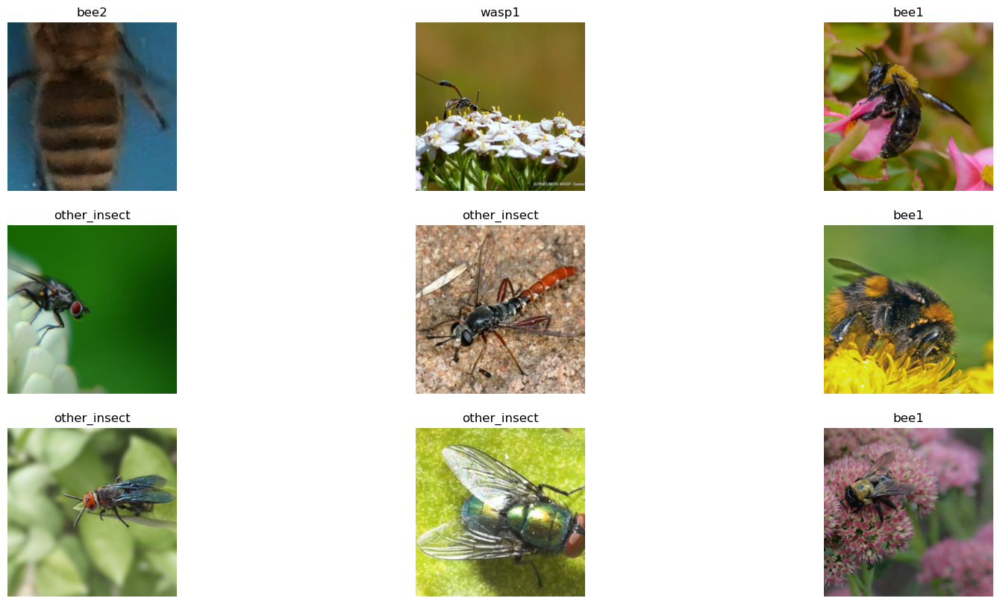

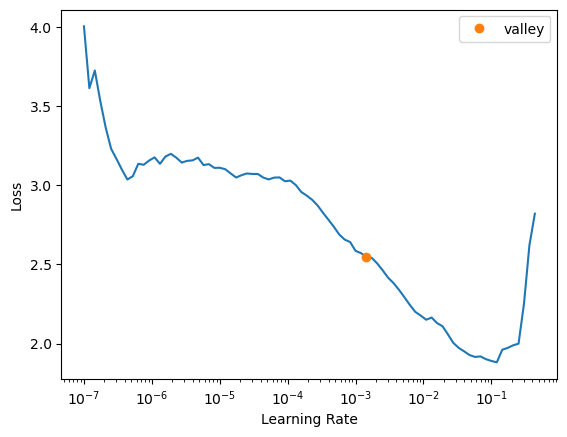

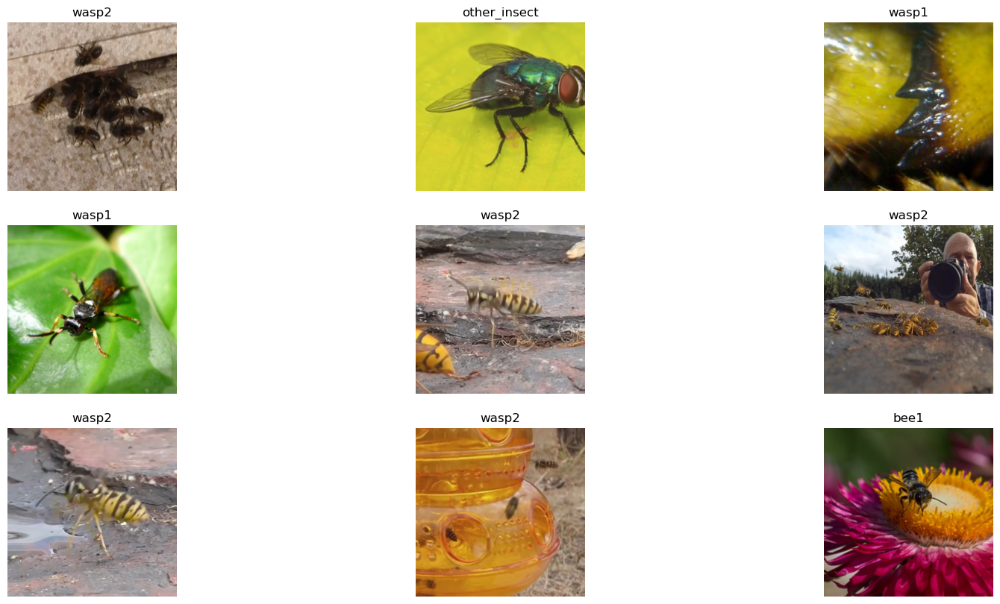

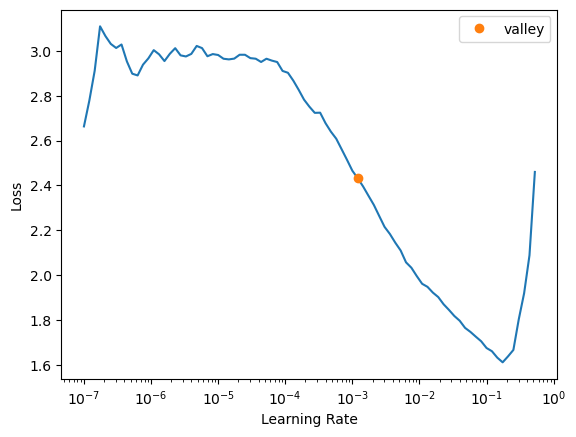

In [17]:
#image size
image_size = 224

#Image path
images_path = "/kaggle/working/images"

#test size
test_size = 0.2

#CNN model
model_type = efficientnet_b1

trial_size = 2

best_efficientnet_learn = optimization_study(image_size, images_path, test_size, model_type, trial_size)

## Automate testing different models
Write custom function call try_models that passes in a list of models so that I can run optuna studies on multiple models. It then selects the trial that did the best overall of all of the models and loads the state, unfreezes all of the weights and retrains with the parameters from the that trial. It finally prints the results, freezes the model again and returns the model.

In [56]:
#| label: custom-trymodels
# Custom function to try different models with the other automation functions
def try_models(image_size, images_path, test_size, models, trial_size):
    best_trials = {}
    for model in models:
        best_trials[model.__name__] = optimization_study(image_size, images_path, test_size, model, trial_size)
        
    best_overall = min(best_trials,  key=lambda x: best_trials[x].value)
    lowest_model = best_trials[best_overall]
    print("\n\nBest Overall Model:", lowest_model.user_attrs['model'].__name__)
    print("Error Rate:", lowest_model.value)
    print("Load Model's state and retrain with best hyperparameters")
    
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{lowest_model.user_attrs['model'].__name__}_state_dict_trial_{lowest_model.number}.pth"

    
    # Retrieve the hyperparameters of the best trial
    hyperparameters = lowest_model.params

    # Access individual hyperparameters
    learning_rate = hyperparameters["learning_rate"]
    batch_size = hyperparameters["batch_size"]
    weight_decay = hyperparameters["weight_decay"]

    #Create model with the same architecture as the best trial and load dict file into it
    best_model_learn = train_models(image_size, batch_size, images_path, test_size, lowest_model.user_attrs["model"])
    best_model_learn.model.load_state_dict(torch.load(best_state_dict_file))

    #unfreeze all weights to train with optimal hyperparameters
    best_model_learn.unfreeze()
    # Fit the model with the best trial's hyperparameters
    best_model_learn.fine_tune(1, base_lr=learning_rate, wd=weight_decay)

    #close it back up
    best_model_learn.freeze()
    
    # Evaluate the model on the validation set
    best_error_rate = best_model_learn.validate()[1]
    
    print(f"\n\nFinal result after training model "+lowest_model.user_attrs['model'].__name__+" with:")
    print("Hyperparameters:", hyperparameters)
    print("Error Rate:", best_error_rate)

    
    #return the model with all of the best results
    return best_model_learn

Test new custom function with squeezenet models and one trial each to conserve Kaggle kernel compute resources. Try it with one trial for each model just to confirm if primarily the try_model function works.

[I 2023-06-08 12:18:10,279] A new study created in memory with name: no-name-8ef8cfa1-afc2-4717-b327-49bbcfcc482b


epoch,train_loss,valid_loss,error_rate,time
0,0.606549,0.304108,0.105517,01:58


epoch,train_loss,valid_loss,error_rate,time
0,0.325303,0.226658,0.073993,02:11


[I 2023-06-08 12:23:17,525] Trial 0 finished with value: 0.07399299740791321 and parameters: {'learning_rate': 0.0012764858673296009, 'batch_size': 32, 'weight_decay': 0.00041991054212174063}. Best is trial 0 with value: 0.07399299740791321.
[I 2023-06-08 12:23:17,531] A new study created in memory with name: no-name-fb1a8138-a034-4ad6-86cd-6dde5d39ac92



For Model: squeezenet1_0
Best Trial: 0
Best Hyperparameters: {'learning_rate': 0.0012764858673296009, 'batch_size': 32, 'weight_decay': 0.00041991054212174063}
Best Error Rate: 0.07399299740791321
Saved best trial's model state as squeezenet1_0_state_dict_trial_0.pth


epoch,train_loss,valid_loss,error_rate,time
0,1.531811,0.774077,0.258319,01:59


epoch,train_loss,valid_loss,error_rate,time
0,1.047019,0.585056,0.200525,02:12


[I 2023-06-08 12:28:12,768] Trial 0 finished with value: 0.20052538812160492 and parameters: {'learning_rate': 3.612884933240133e-05, 'batch_size': 16, 'weight_decay': 0.0004649197880343587}. Best is trial 0 with value: 0.20052538812160492.



For Model: squeezenet1_1
Best Trial: 0
Best Hyperparameters: {'learning_rate': 3.612884933240133e-05, 'batch_size': 16, 'weight_decay': 0.0004649197880343587}
Best Error Rate: 0.20052538812160492
Saved best trial's model state as squeezenet1_1_state_dict_trial_0.pth


Best Overall Model: squeezenet1_0
Error Rate: 0.07399299740791321
Load Model's state and retrain with best hyperparameters


epoch,train_loss,valid_loss,error_rate,time
0,0.324695,0.193842,0.067863,02:01


epoch,train_loss,valid_loss,error_rate,time
0,0.275281,0.164468,0.049912,02:13




Final result after training model squeezenet1_0 with:
Hyperparameters: {'learning_rate': 0.0012764858673296009, 'batch_size': 32, 'weight_decay': 0.00041991054212174063}
Error Rate: 0.049912434071302414


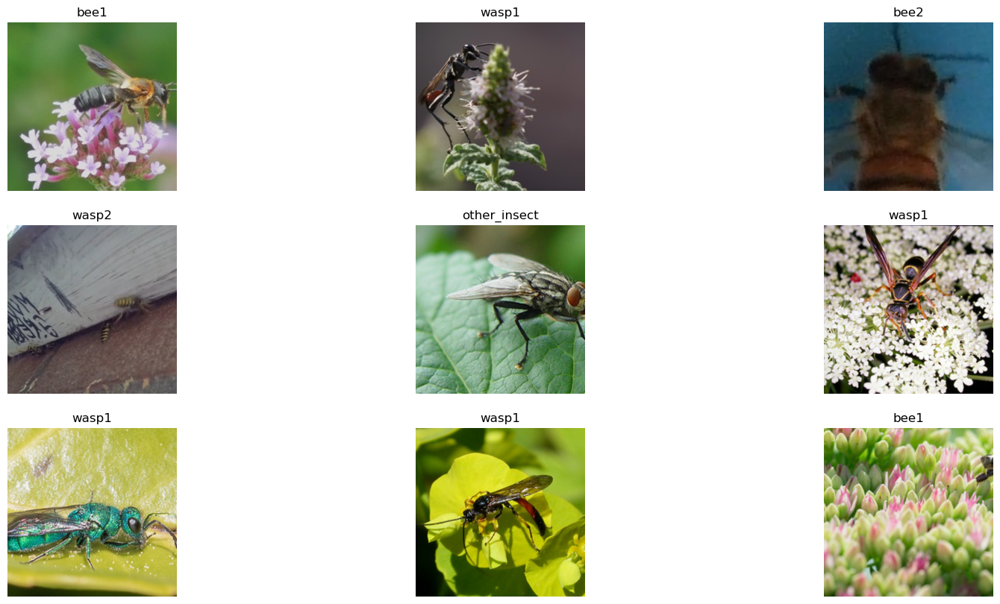

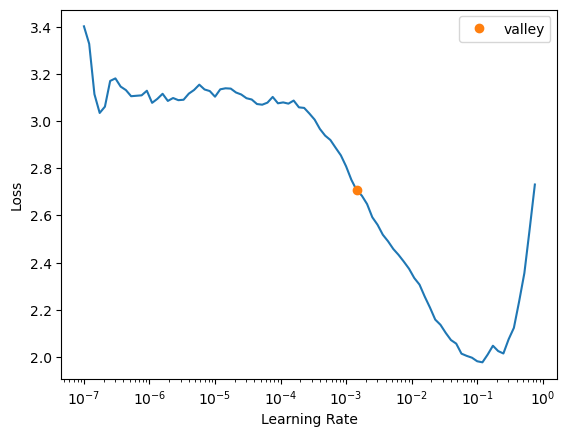

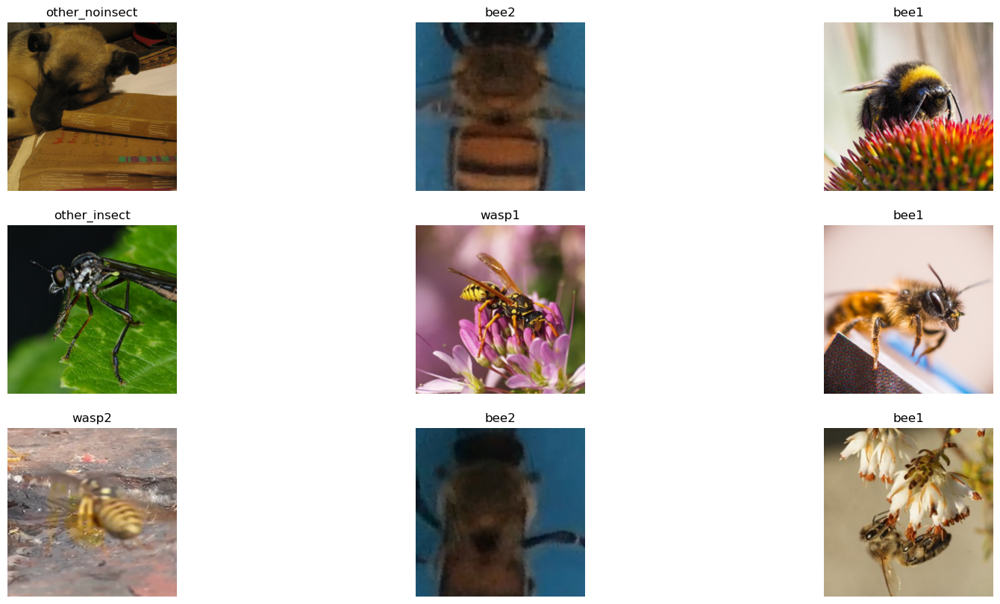

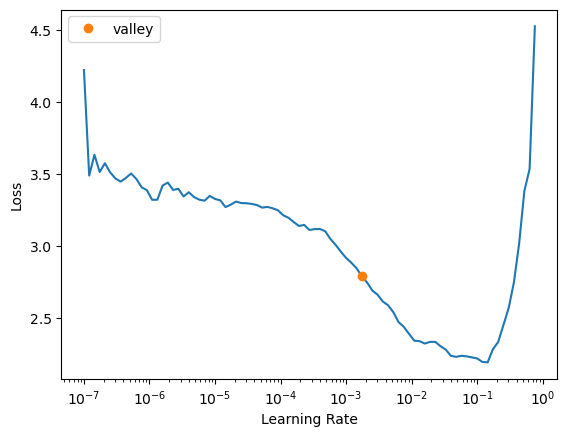

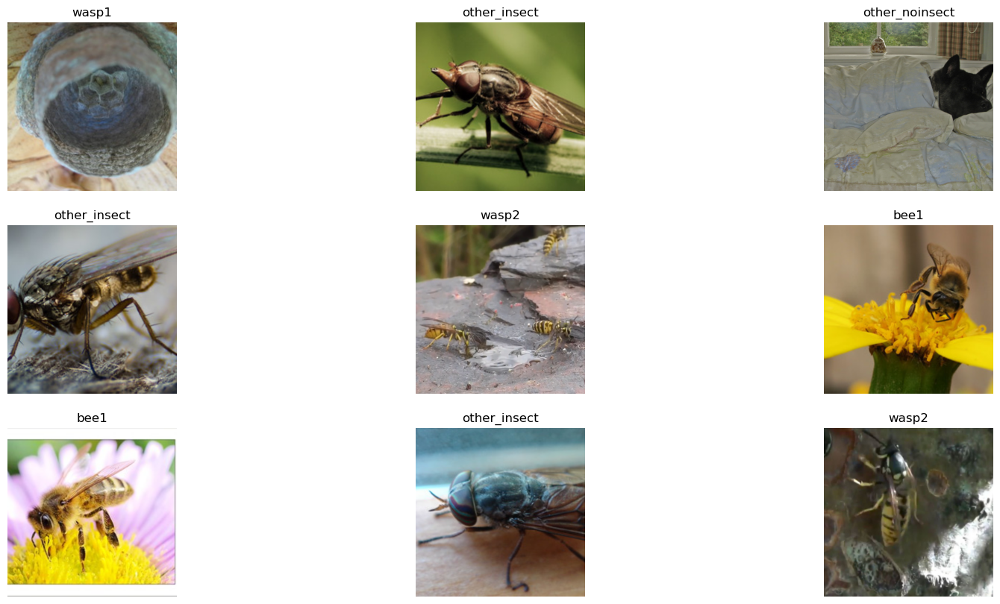

In [57]:
#image size
image_size = 224

#Image path
images_path = "/kaggle/working/images"

#test size
test_size = 0.2

#list of models to test on dataset
models = [squeezenet1_0, squeezenet1_1]

#trial sizes of studies for each model
trial_size = 1

#Get model with the best training results
optimized_model = try_models(image_size, images_path, test_size, models, trial_size)

Test again this time with two trials for each model to confirm the optimization_study function is working properly and that the best trial from the best model is being selected at the end for further training with unfrozen weights.

In [58]:
#function to tune automate tuning
def tune_hyperparameters(trial, image_size, images_path, test_size, model_type):
    # Define the hyperparameters to tune
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 1e-1)
    batch_size = trial.suggest_categorical("batch_size", [16, 32, 64])
    weight_decay = trial.suggest_loguniform("weight_decay", 1e-5, 1e-3)

    #Create model with dataset and parameters
    learn = train_models(image_size, batch_size, images_path, test_size, model_type)

    # Define the hyperparameters of the fastai learner
    learn.lr_find()

    # Fit the model with the hyperparameters
    learn.fine_tune(1, base_lr=learning_rate, wd=weight_decay)

    # Evaluate the model on the validation set
    error_rate = learn.validate()[1]
    
    # Specify the directory and file name for saving the state dictionary
    model_state_dict_file = f"/kaggle/working/{model_type.__name__}_state_dict_trial_{trial.number}.pth"

    # Save the model's state dictionary
    torch.save(learn.model.state_dict(), model_state_dict_file)

    return error_rate

#function to run trials optimizing for the tune_hyperparameters function
def optimization_study(image_size, images_path, test_size, selected_model, trial_size):

    # Create an Optuna study and optimize the tune_hyperparameters function
    study = optuna.create_study(direction="minimize") # Minimize the error rate
    study.optimize(lambda trial: tune_hyperparameters(trial, image_size, images_path, test_size, selected_model), n_trials=trial_size)

    # Print the best hyperparameters and the corresponding accuracy
    best_params = study.best_params
    best_error_rate = study.best_value
    print("\nFor Model:", selected_model.__name__)
    print("Best Trial:", study.best_trial.number)
    print("Best Hyperparameters:", best_params)
    print("Best Error Rate:", best_error_rate)
    print(f"Saved best trial's model state as {selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth")
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth"

    # Get the best trial from the study
    best_trial = study.trials[study.best_trial.number]
    
    #save the model type in the trial to retrieve later
    best_trial.user_attrs['model'] = selected_model
    
    return best_trial
    
#function to try different models with the optimization_study function
def try_models(image_size, images_path, test_size, models, trial_size):
    best_trials = {}
    for model in models:
        best_trials[model.__name__] = optimization_study(image_size, images_path, test_size, model, trial_size)
        
    best_overall = min(best_trials,  key=lambda x: best_trials[x].value)
    lowest_model = best_trials[best_overall]
    print("\n\nBest Overall Model:", lowest_model.user_attrs['model'].__name__)
    print("Error Rate:", lowest_model.value)
    print("Load Model's state and retrain with best hyperparameters")
    
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{lowest_model.user_attrs['model'].__name__}_state_dict_trial_{lowest_model.number}.pth"

    
    # Retrieve the hyperparameters of the best trial
    hyperparameters = lowest_model.params

    # Access individual hyperparameters
    learning_rate = hyperparameters["learning_rate"]
    batch_size = hyperparameters["batch_size"]
    weight_decay = hyperparameters["weight_decay"]

    #Create model with the same architecture as the best trial and load dict file into it
    best_model_learn = train_models(image_size, batch_size, images_path, test_size, lowest_model.user_attrs["model"])
    best_model_learn.model.load_state_dict(torch.load(best_state_dict_file))

    #unfreeze all weights to train with optimal hyperparameters
    best_model_learn.unfreeze()
    # Fit the model with the best trial's hyperparameters
    best_model_learn.fine_tune(1, base_lr=learning_rate, wd=weight_decay)

    #close it back up
    best_model_learn.freeze()
    
    # Evaluate the model on the validation set
    best_error_rate = best_model_learn.validate()[1]
    
    print(f"\n\nFinal result after training model "+lowest_model.user_attrs['model'].__name__+" with:")
    print("Hyperparameters:", hyperparameters)
    print("Error Rate:", best_error_rate)

    #return the model with all of the best results
    return best_model_learn

[I 2023-06-08 12:39:23,845] A new study created in memory with name: no-name-56c1fd88-fbae-41d1-a31c-80337d509417


epoch,train_loss,valid_loss,error_rate,time
0,1.226344,0.699265,0.232487,02:02


epoch,train_loss,valid_loss,error_rate,time
0,0.988400,0.582858,0.186953,02:19


[I 2023-06-08 12:44:27,883] Trial 0 finished with value: 0.18695271015167236 and parameters: {'learning_rate': 5.015041644534575e-05, 'batch_size': 16, 'weight_decay': 0.0004250181872133549}. Best is trial 0 with value: 0.18695271015167236.


epoch,train_loss,valid_loss,error_rate,time
0,0.649310,0.304367,0.102014,01:56


epoch,train_loss,valid_loss,error_rate,time
0,0.336163,0.221133,0.076182,02:08


[I 2023-06-08 12:50:02,491] Trial 1 finished with value: 0.07618213444948196 and parameters: {'learning_rate': 0.0023734986075873033, 'batch_size': 64, 'weight_decay': 0.0007952925299974862}. Best is trial 1 with value: 0.07618213444948196.
[I 2023-06-08 12:50:02,497] A new study created in memory with name: no-name-f0eb0f23-c078-4eb4-bdb0-ecb35cfcb9a7



For Model: squeezenet1_0
Best Trial: 1
Best Hyperparameters: {'learning_rate': 0.0023734986075873033, 'batch_size': 64, 'weight_decay': 0.0007952925299974862}
Best Error Rate: 0.07618213444948196
Saved best trial's model state as squeezenet1_0_state_dict_trial_1.pth


epoch,train_loss,valid_loss,error_rate,time
0,0.680173,0.424658,0.145797,02:00


epoch,train_loss,valid_loss,error_rate,time
0,0.369279,0.236451,0.080560,02:12


[I 2023-06-08 12:54:57,659] Trial 0 finished with value: 0.08056042343378067 and parameters: {'learning_rate': 0.005293140445117593, 'batch_size': 16, 'weight_decay': 0.0007318992747687618}. Best is trial 0 with value: 0.08056042343378067.


epoch,train_loss,valid_loss,error_rate,time
0,0.586318,0.377740,0.116900,01:54


epoch,train_loss,valid_loss,error_rate,time
0,0.370460,0.252543,0.083625,01:58


[I 2023-06-08 13:00:17,150] Trial 1 finished with value: 0.08362521976232529 and parameters: {'learning_rate': 0.010654437485882372, 'batch_size': 64, 'weight_decay': 4.493120518151793e-05}. Best is trial 0 with value: 0.08056042343378067.



For Model: squeezenet1_1
Best Trial: 0
Best Hyperparameters: {'learning_rate': 0.005293140445117593, 'batch_size': 16, 'weight_decay': 0.0007318992747687618}
Best Error Rate: 0.08056042343378067
Saved best trial's model state as squeezenet1_1_state_dict_trial_0.pth


Best Overall Model: squeezenet1_0
Error Rate: 0.07618213444948196
Load Model's state and retrain with best hyperparameters


epoch,train_loss,valid_loss,error_rate,time
0,0.280451,0.226759,0.083187,01:56


epoch,train_loss,valid_loss,error_rate,time
0,0.238665,0.165124,0.062609,02:06




Final result after training model squeezenet1_0 with:
Hyperparameters: {'learning_rate': 0.0023734986075873033, 'batch_size': 64, 'weight_decay': 0.0007952925299974862}
Error Rate: 0.06260945647954941


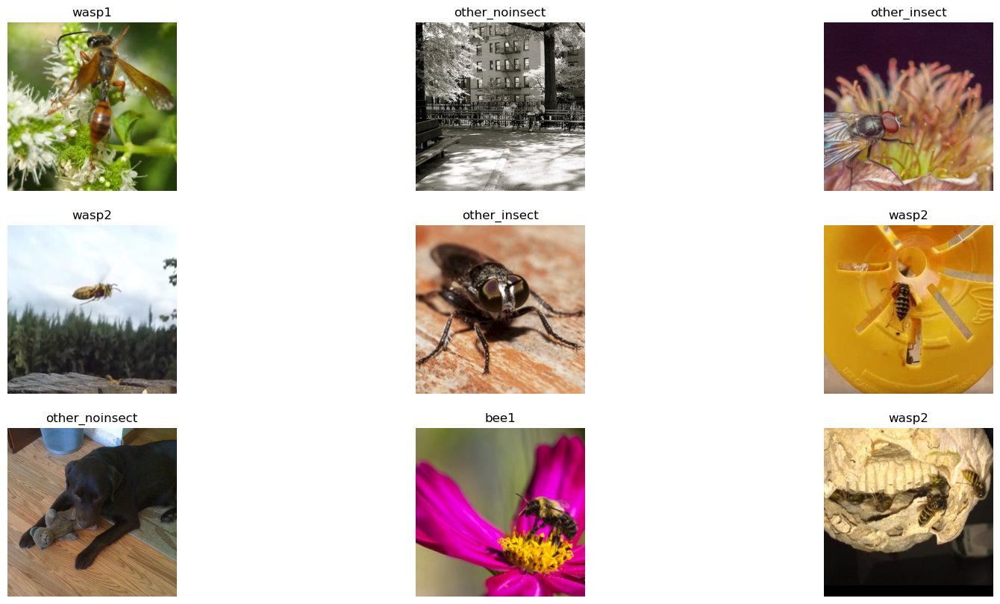

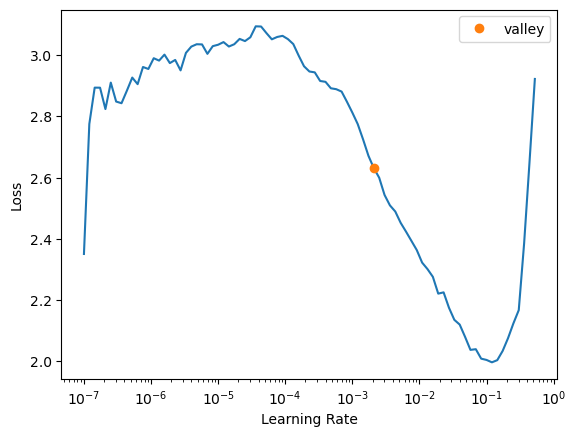

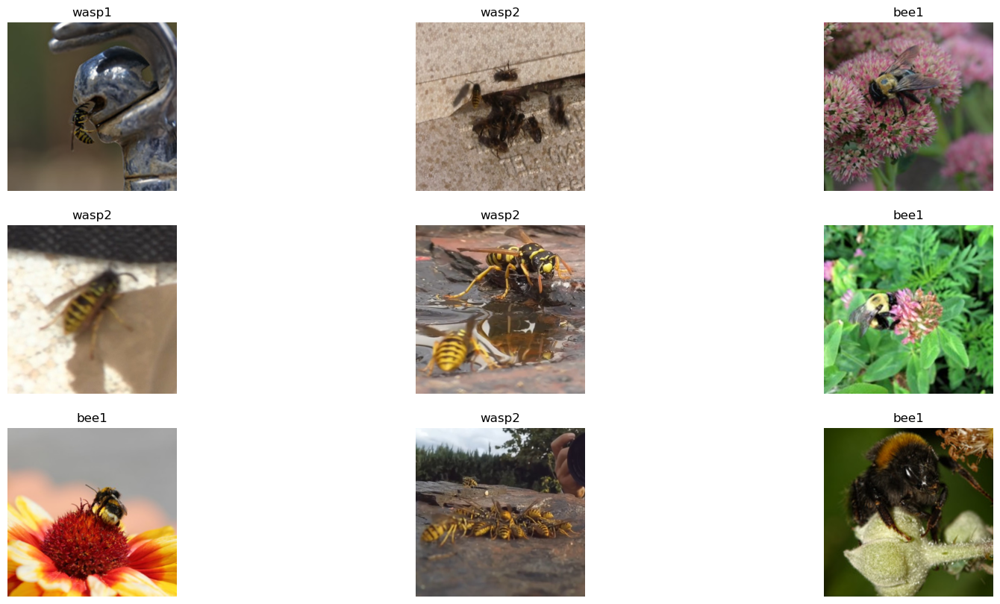

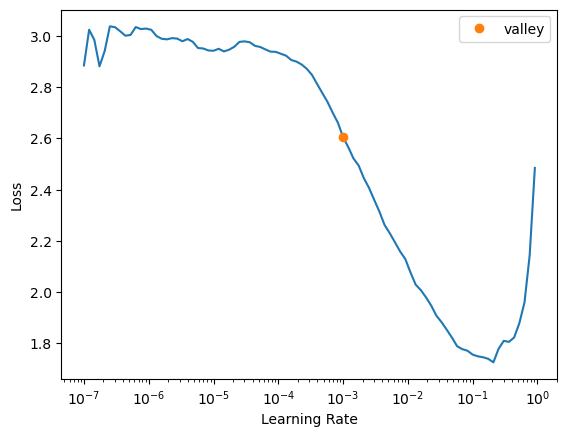

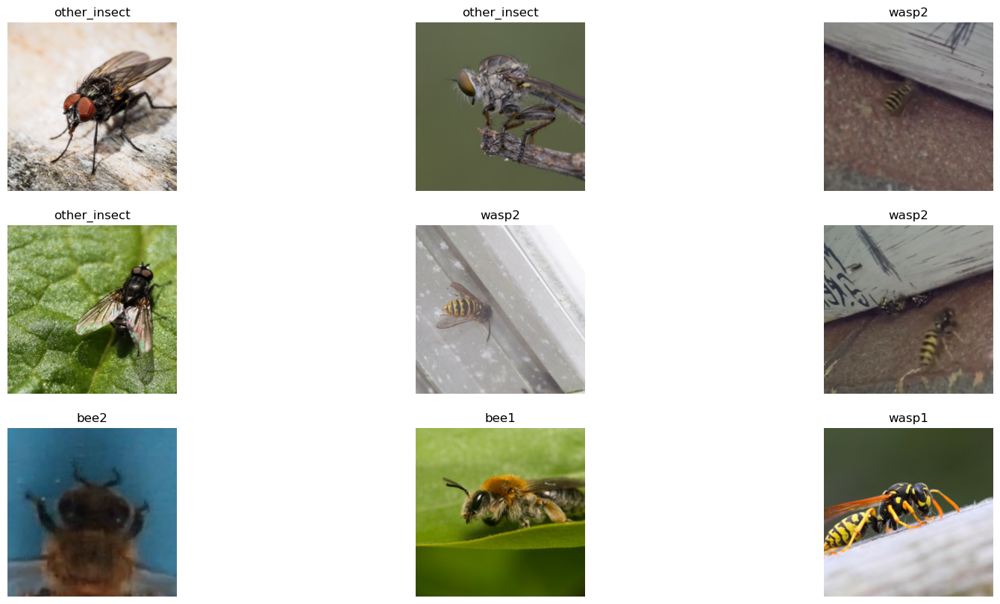

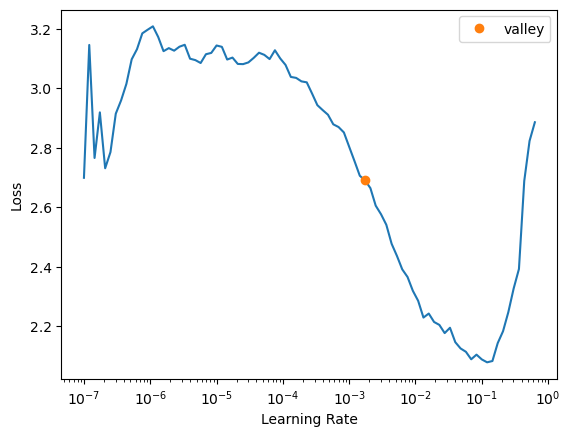

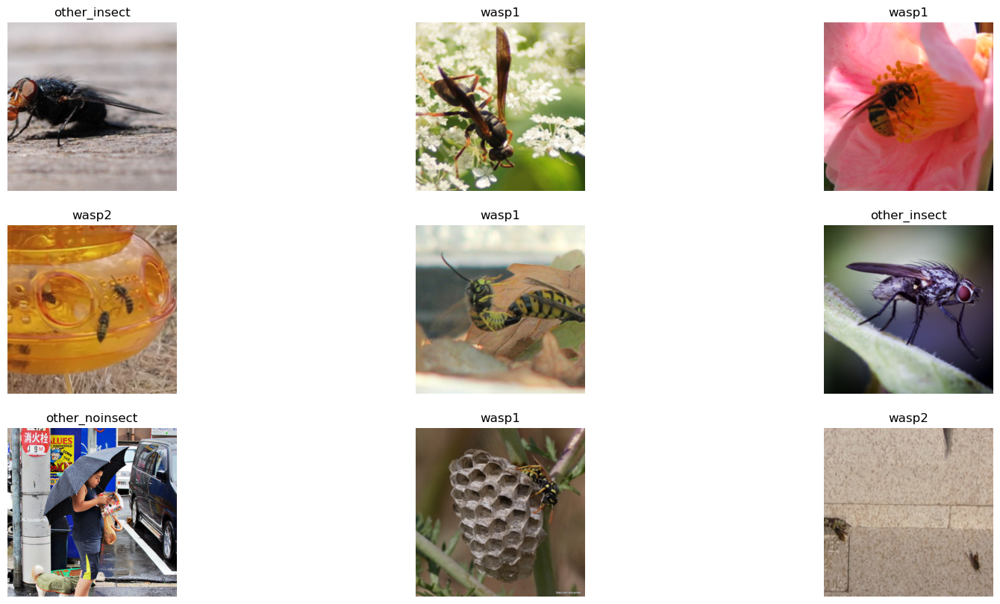

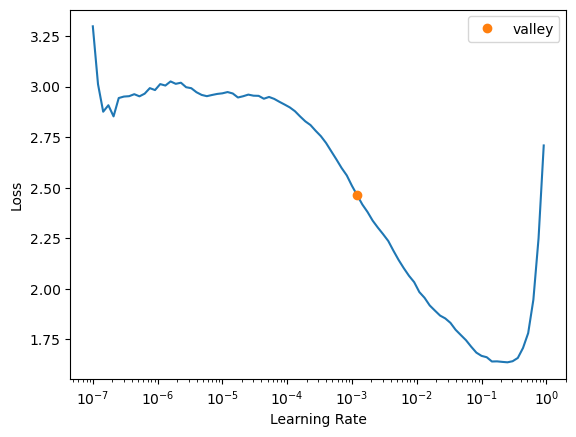

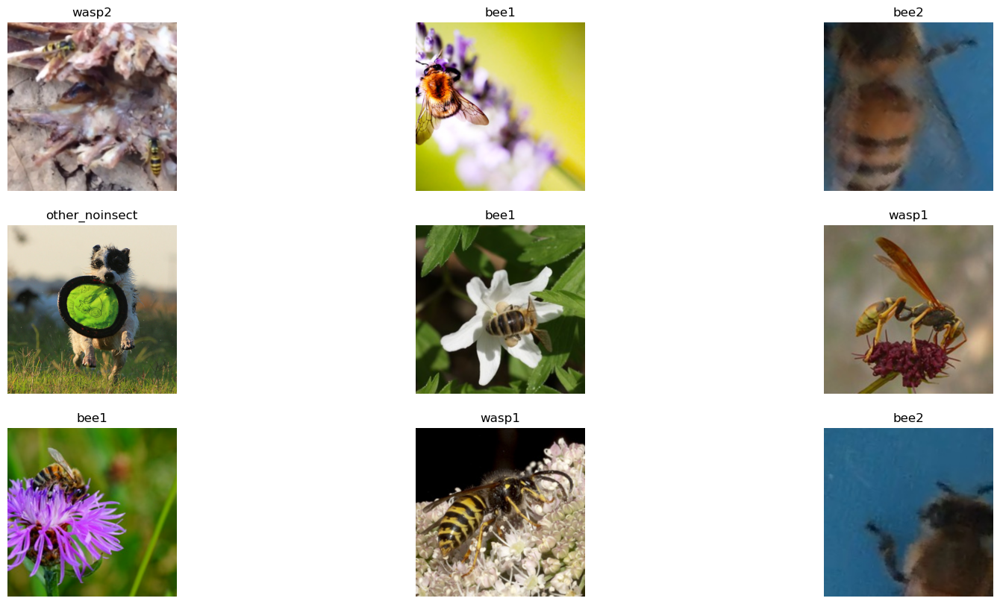

In [59]:
#image size
image_size = 224

#Image path
images_path = "/kaggle/working/images"

#test size
test_size = 0.2

#list of models to test on dataset
models = [squeezenet1_0, squeezenet1_1]

#trial sizes of studies for each model
trial_size = 2

#Get model with the best training results
optimized_model = try_models(image_size, images_path, test_size, models, trial_size)

Now alter custom functions by increases training epochs so that optimization functions can do a better job. Also add data augmentation into train_models function to randomly crop image to specified size and randomly flip image horizontally. These changes should produce a far more robust result!

In [19]:
from torchvision import transforms

#Function to train models more easily
def train_models(image_size, batch_size, images_path, test_size, model_type):
    # Data augmentation transforms
    augmentation_transforms = [
        transforms.RandomResizedCrop(image_size),
        transforms.RandomHorizontalFlip()
    ]

    #instructions for preparing data batches, size of images
    #and normalize data
    batch_tfms = [*augmentation_transforms, Normalize.from_stats(*imagenet_stats)]

    #function for creating batches with specified parameters
    data = ImageDataLoaders.from_folder(images_path,
                                        valid_pct=test_size,
                                        ds_tfms=batch_tfms,
                                        item_tfms=Resize(460),
                                        bs=batch_size)
    
    # test whether batch function is working with parameters
    data.show_batch(max_n=9, figsize=(20,10))

    #return the trained model
    return vision_learner(data, model_type, metrics=error_rate).to_fp16()

#function to tune automate tuning
def tune_hyperparameters(trial, image_size, images_path, test_size, model_type):
    # Define the hyperparameters to tune
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 1e-1)
    batch_size = trial.suggest_categorical("batch_size", [16, 32, 64])
    weight_decay = trial.suggest_loguniform("weight_decay", 1e-5, 1e-3)

    #Create model with dataset and parameters
    learn = train_models(image_size, batch_size, images_path, test_size, model_type)

    # Define the hyperparameters of the fastai learner
    learn.lr_find()

    # Fit the model with the hyperparameters
    learn.fine_tune(4, base_lr=learning_rate, wd=weight_decay)

    # Evaluate the model on the validation set
    error_rate = learn.validate()[1]
    
    # Specify the directory and file name for saving the state dictionary
    model_state_dict_file = f"/kaggle/working/{model_type.__name__}_state_dict_trial_{trial.number}.pth"

    # Save the model's state dictionary
    torch.save(learn.model.state_dict(), model_state_dict_file)

    return error_rate

#function to run trials optimizing for the tune_hyperparameters function
def optimization_study(image_size, images_path, test_size, selected_model, trial_size):

    # Create an Optuna study and optimize the tune_hyperparameters function
    study = optuna.create_study(direction="minimize") # Minimize the error rate
    study.optimize(lambda trial: tune_hyperparameters(trial, image_size, images_path, test_size, selected_model), n_trials=trial_size)

    # Print the best hyperparameters and the corresponding accuracy
    best_params = study.best_params
    best_error_rate = study.best_value
    print("\nFor Model:", selected_model.__name__)
    print("Best Trial:", study.best_trial.number)
    print("Best Hyperparameters:", best_params)
    print("Best Error Rate:", best_error_rate)
    print(f"Saved best trial's model state as {selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth")
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth"

    # Get the best trial from the study
    best_trial = study.trials[study.best_trial.number]
    
    #save the model type in the trial to retrieve later
    best_trial.user_attrs['model'] = selected_model
    
    return best_trial
    
#function to try different models with the optimization_study function
def try_models(image_size, images_path, test_size, models, trial_size):
    best_trials = {}
    for model in models:
        best_trials[model.__name__] = optimization_study(image_size, images_path, test_size, model, trial_size)
        
    best_overall = min(best_trials,  key=lambda x: best_trials[x].value)
    lowest_model = best_trials[best_overall]
    print("\n\nBest Overall Model:", lowest_model.user_attrs['model'].__name__)
    print("Error Rate:", lowest_model.value)
    print("Load Model's state and retrain with best hyperparameters")
    
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{lowest_model.user_attrs['model'].__name__}_state_dict_trial_{lowest_model.number}.pth"

    
    # Retrieve the hyperparameters of the best trial
    hyperparameters = lowest_model.params

    # Access individual hyperparameters
    learning_rate = hyperparameters["learning_rate"]
    batch_size = hyperparameters["batch_size"]
    weight_decay = hyperparameters["weight_decay"]

    #Create model with the same architecture as the best trial and load dict file into it
    best_model_learn = train_models(image_size, batch_size, images_path, test_size, lowest_model.user_attrs["model"])
    best_model_learn.model.load_state_dict(torch.load(best_state_dict_file))

    #unfreeze all weights to train with optimal hyperparameters
    best_model_learn.unfreeze()
    # Fit the model with the best trial's hyperparameters
    best_model_learn.fine_tune(4, base_lr=learning_rate, wd=weight_decay)

    #close it back up
    best_model_learn.freeze()
    
    # Evaluate the model on the validation set
    best_error_rate = best_model_learn.validate()[1]
    
    print(f"\n\nFinal result after training model "+lowest_model.user_attrs['model'].__name__+" with:")
    print("Hyperparameters:", hyperparameters)
    print("Error Rate:", best_error_rate)

    #return the model with all of the best results
    return best_model_learn

[I 2023-06-08 13:38:16,840] A new study created in memory with name: no-name-babdd055-730b-474d-8bce-3f8c08afff26


epoch,train_loss,valid_loss,error_rate,time
0,0.678758,0.352693,0.110333,01:59


epoch,train_loss,valid_loss,error_rate,time
0,0.447532,0.285948,0.091506,02:13
1,0.338005,0.250532,0.080560,02:11
2,0.278113,0.222754,0.074869,02:11
3,0.248770,0.220108,0.075306,02:11


[I 2023-06-08 13:50:02,896] Trial 0 finished with value: 0.0753064826130867 and parameters: {'learning_rate': 0.0005287663755603432, 'batch_size': 32, 'weight_decay': 0.0008201401389126385}. Best is trial 0 with value: 0.0753064826130867.


epoch,train_loss,valid_loss,error_rate,time
0,0.859604,0.433729,0.150175,02:01


epoch,train_loss,valid_loss,error_rate,time
0,0.674439,0.329440,0.111646,02:19
1,0.468562,0.294786,0.091944,02:20
2,0.484489,0.251511,0.079247,02:20
3,0.446737,0.251365,0.080123,02:18


[I 2023-06-08 14:02:06,644] Trial 1 finished with value: 0.08012259006500244 and parameters: {'learning_rate': 0.00015609051402617753, 'batch_size': 16, 'weight_decay': 2.0799287492654444e-05}. Best is trial 0 with value: 0.0753064826130867.


epoch,train_loss,valid_loss,error_rate,time
0,1.569642,0.682373,0.222417,01:57


epoch,train_loss,valid_loss,error_rate,time
0,0.967422,0.550527,0.177758,02:11
1,0.747162,0.425511,0.135727,02:10
2,0.659322,0.376895,0.118214,02:07
3,0.572101,0.374642,0.118214,02:13


[I 2023-06-08 14:14:17,335] Trial 2 finished with value: 0.11821366101503372 and parameters: {'learning_rate': 9.361103108146438e-05, 'batch_size': 64, 'weight_decay': 0.00015158496762581182}. Best is trial 0 with value: 0.0753064826130867.


epoch,train_loss,valid_loss,error_rate,time
0,2.739013,1.699901,0.634851,01:58


epoch,train_loss,valid_loss,error_rate,time
0,2.275047,1.490521,0.547285,02:09
1,1.930345,1.216926,0.433888,02:09
2,1.783499,1.087139,0.384413,02:09
3,1.683445,1.095101,0.385727,02:10


[I 2023-06-08 14:26:24,000] Trial 3 finished with value: 0.38572680950164795 and parameters: {'learning_rate': 1.1298977450662667e-05, 'batch_size': 64, 'weight_decay': 8.394665728431671e-05}. Best is trial 0 with value: 0.0753064826130867.


epoch,train_loss,valid_loss,error_rate,time
0,1.853489,0.848470,0.283275,01:59


epoch,train_loss,valid_loss,error_rate,time
0,1.133737,0.674505,0.229422,02:11
1,0.881264,0.533875,0.180823,02:11
2,0.767295,0.482925,0.163310,02:11
3,0.713160,0.474486,0.163748,02:09


[I 2023-06-08 14:38:38,723] Trial 4 finished with value: 0.16374781727790833 and parameters: {'learning_rate': 6.926275529586425e-05, 'batch_size': 64, 'weight_decay': 0.0007041420447735719}. Best is trial 0 with value: 0.0753064826130867.
[I 2023-06-08 14:38:38,730] A new study created in memory with name: no-name-5a6f2725-b98c-40b5-9a0a-9c876f768d88



For Model: squeezenet1_0
Best Trial: 0
Best Hyperparameters: {'learning_rate': 0.0005287663755603432, 'batch_size': 32, 'weight_decay': 0.0008201401389126385}
Best Error Rate: 0.0753064826130867
Saved best trial's model state as squeezenet1_0_state_dict_trial_0.pth


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-3dd342df.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 72.5MB/s]


epoch,train_loss,valid_loss,error_rate,time
0,0.599530,0.280826,0.090193,02:21


epoch,train_loss,valid_loss,error_rate,time
0,0.377831,0.230834,0.077058,02:48
1,0.353884,0.192275,0.063923,02:50
2,0.286904,0.185272,0.063485,02:49
3,0.270328,0.184002,0.057793,02:49


[I 2023-06-08 14:53:25,798] Trial 0 finished with value: 0.05779334530234337 and parameters: {'learning_rate': 0.00042751066482411945, 'batch_size': 32, 'weight_decay': 0.00014042494617814825}. Best is trial 0 with value: 0.05779334530234337.


epoch,train_loss,valid_loss,error_rate,time
0,2.067304,0.936416,0.330998,02:16


epoch,train_loss,valid_loss,error_rate,time
0,1.313559,0.684647,0.240368,02:29
1,0.977611,0.522313,0.165499,02:29
2,0.840569,0.467215,0.155867,02:30
3,0.791642,0.444840,0.140543,02:30


[I 2023-06-08 15:07:25,826] Trial 1 finished with value: 0.1405429095029831 and parameters: {'learning_rate': 2.5538228750896438e-05, 'batch_size': 64, 'weight_decay': 1.0648873130918324e-05}. Best is trial 0 with value: 0.05779334530234337.


epoch,train_loss,valid_loss,error_rate,time
0,2.282475,1.201832,0.441769,02:17


epoch,train_loss,valid_loss,error_rate,time
0,1.576555,0.904013,0.320490,02:29
1,1.246441,0.656489,0.216287,02:31
2,1.027223,0.563563,0.190893,02:31
3,0.962607,0.552865,0.181699,02:31


[I 2023-06-08 15:21:30,770] Trial 2 finished with value: 0.1816987693309784 and parameters: {'learning_rate': 1.8237976115416836e-05, 'batch_size': 64, 'weight_decay': 0.00012569342953599568}. Best is trial 0 with value: 0.05779334530234337.


epoch,train_loss,valid_loss,error_rate,time
0,0.510639,0.325047,0.098511,02:32


epoch,train_loss,valid_loss,error_rate,time
0,0.325897,0.243754,0.074431,03:23
1,0.311516,0.191647,0.061734,03:24
2,0.179462,0.186471,0.051664,03:20
3,0.158553,0.166508,0.049912,03:23


[I 2023-06-08 15:38:25,107] Trial 3 finished with value: 0.049912434071302414 and parameters: {'learning_rate': 0.003239568239099656, 'batch_size': 16, 'weight_decay': 1.735644194924399e-05}. Best is trial 3 with value: 0.049912434071302414.


epoch,train_loss,valid_loss,error_rate,time
0,0.507608,0.311039,0.096322,02:36


epoch,train_loss,valid_loss,error_rate,time
0,0.409390,0.228301,0.072680,03:25
1,0.323644,0.187608,0.063485,03:23
2,0.249844,0.184639,0.060420,03:26
3,0.237328,0.171259,0.056480,03:24


[I 2023-06-08 15:55:33,588] Trial 4 finished with value: 0.056479860097169876 and parameters: {'learning_rate': 0.0011342464412962283, 'batch_size': 16, 'weight_decay': 2.9967821222954056e-05}. Best is trial 3 with value: 0.049912434071302414.
[I 2023-06-08 15:55:33,596] A new study created in memory with name: no-name-349d8e60-e134-4911-b786-29cf5e630b00



For Model: efficientnet_b0
Best Trial: 3
Best Hyperparameters: {'learning_rate': 0.003239568239099656, 'batch_size': 16, 'weight_decay': 1.735644194924399e-05}
Best Error Rate: 0.049912434071302414
Saved best trial's model state as efficientnet_b0_state_dict_trial_3.pth


Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 60.0MB/s]


epoch,train_loss,valid_loss,error_rate,time
0,0.539608,0.354832,0.108144,02:18


epoch,train_loss,valid_loss,error_rate,time
0,0.396845,0.665795,0.176445,02:24
1,0.303692,0.212948,0.082312,02:25
2,0.169119,0.148486,0.046848,02:25
3,0.088451,0.135926,0.044658,02:26


[I 2023-06-08 16:08:41,638] Trial 0 finished with value: 0.044658493250608444 and parameters: {'learning_rate': 0.010702778907093483, 'batch_size': 32, 'weight_decay': 0.0007610375349820089}. Best is trial 0 with value: 0.044658493250608444.


epoch,train_loss,valid_loss,error_rate,time
0,0.559045,0.293187,0.102014,02:24


epoch,train_loss,valid_loss,error_rate,time
0,0.345877,0.194752,0.064361,02:38
1,0.246514,0.159141,0.056480,02:38
2,0.149530,0.146245,0.049912,02:38
3,0.090802,0.142847,0.044658,02:38


[I 2023-06-08 16:22:29,023] Trial 1 finished with value: 0.044658493250608444 and parameters: {'learning_rate': 0.0006306547118611884, 'batch_size': 16, 'weight_decay': 0.0001562622111509353}. Best is trial 0 with value: 0.044658493250608444.


epoch,train_loss,valid_loss,error_rate,time
0,0.503531,0.308124,0.096322,02:16


epoch,train_loss,valid_loss,error_rate,time
0,0.405382,0.514021,0.155429,02:23
1,0.317077,0.262243,0.087128,02:23
2,0.169791,0.152173,0.044658,02:23
3,0.087411,0.148640,0.041156,02:22


[I 2023-06-08 16:35:25,126] Trial 2 finished with value: 0.0411558672785759 and parameters: {'learning_rate': 0.008313401044958223, 'batch_size': 32, 'weight_decay': 0.0007188199256669531}. Best is trial 2 with value: 0.0411558672785759.


epoch,train_loss,valid_loss,error_rate,time
0,0.588322,0.331175,0.101576,02:22


epoch,train_loss,valid_loss,error_rate,time
0,0.305756,0.213444,0.065674,02:37
1,0.233765,0.175919,0.055604,02:37
2,0.109106,0.181506,0.052102,02:38
3,0.065777,0.175606,0.050788,02:37


[I 2023-06-08 16:49:06,368] Trial 3 finished with value: 0.050788089632987976 and parameters: {'learning_rate': 0.0011360283417582722, 'batch_size': 16, 'weight_decay': 2.8535320734402067e-05}. Best is trial 2 with value: 0.0411558672785759.


epoch,train_loss,valid_loss,error_rate,time
0,0.740829,0.642002,0.127846,02:22


epoch,train_loss,valid_loss,error_rate,time
0,0.596929,0.643570,0.236865,02:38
1,0.419123,0.361727,0.115587,02:37
2,0.263559,0.198628,0.069177,02:38
3,0.157862,0.170973,0.055604,02:38


[I 2023-06-08 17:02:51,493] Trial 4 finished with value: 0.055604204535484314 and parameters: {'learning_rate': 0.019721909362473974, 'batch_size': 16, 'weight_decay': 0.00013190815690827706}. Best is trial 2 with value: 0.0411558672785759.



For Model: resnet34
Best Trial: 2
Best Hyperparameters: {'learning_rate': 0.008313401044958223, 'batch_size': 32, 'weight_decay': 0.0007188199256669531}
Best Error Rate: 0.0411558672785759
Saved best trial's model state as resnet34_state_dict_trial_2.pth


Best Overall Model: resnet34
Error Rate: 0.0411558672785759
Load Model's state and retrain with best hyperparameters


epoch,train_loss,valid_loss,error_rate,time
0,0.152131,0.107886,0.032399,02:16


epoch,train_loss,valid_loss,error_rate,time
0,0.219400,0.204009,0.060858,02:23
1,0.191460,0.240030,0.074431,02:23
2,0.098248,0.116806,0.039842,02:21
3,0.037225,0.112832,0.035026,02:23




Final result after training model resnet34 with:
Hyperparameters: {'learning_rate': 0.008313401044958223, 'batch_size': 32, 'weight_decay': 0.0007188199256669531}
Error Rate: 0.035026270896196365


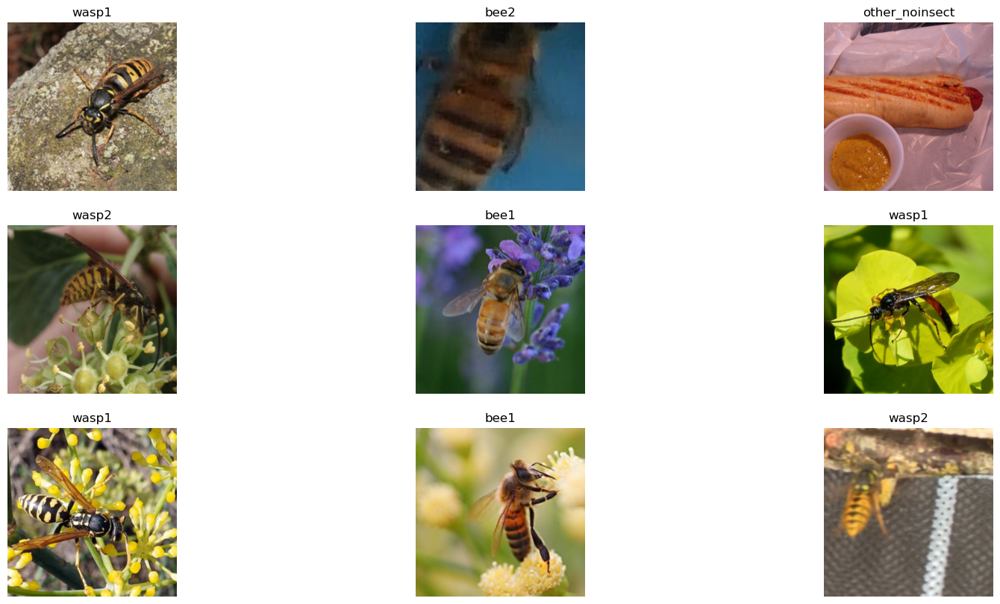

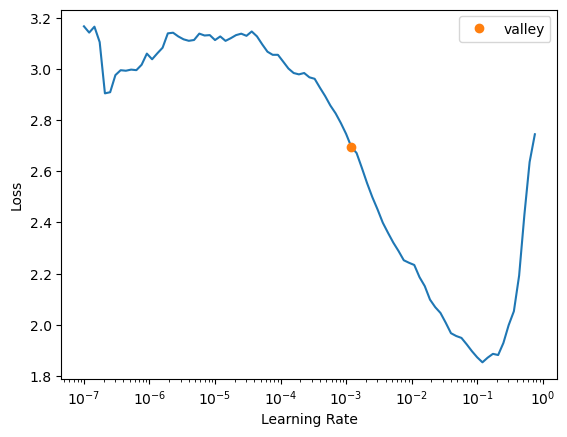

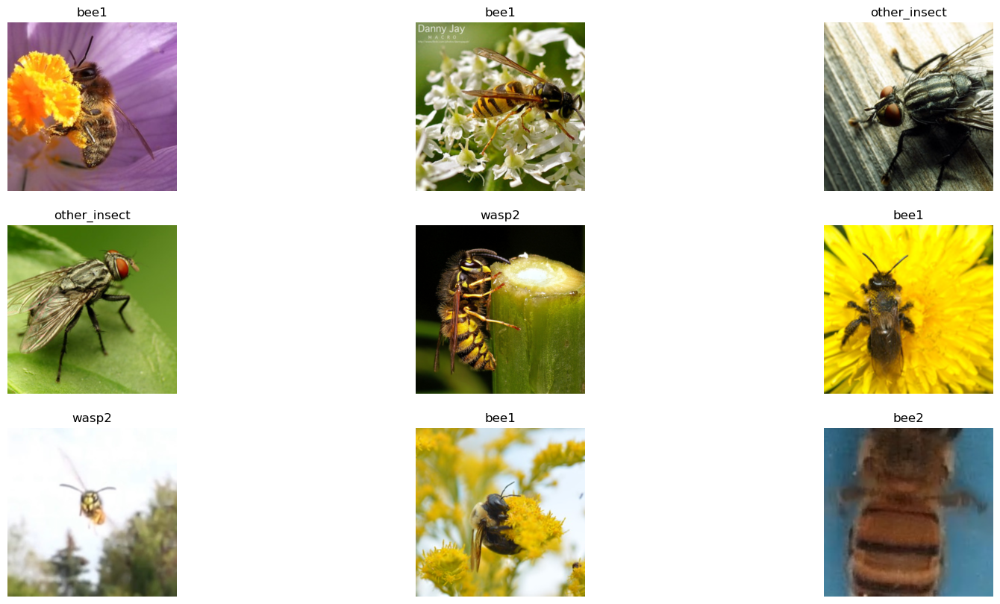

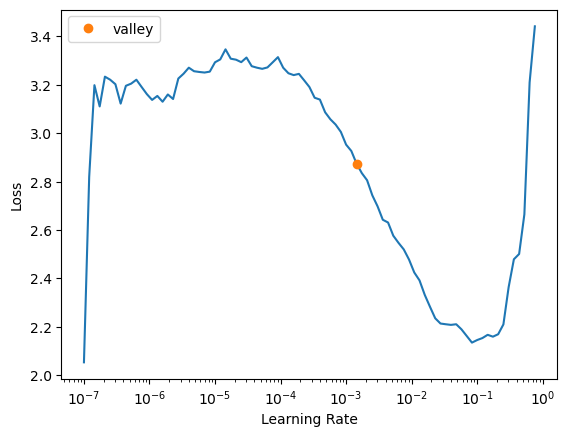

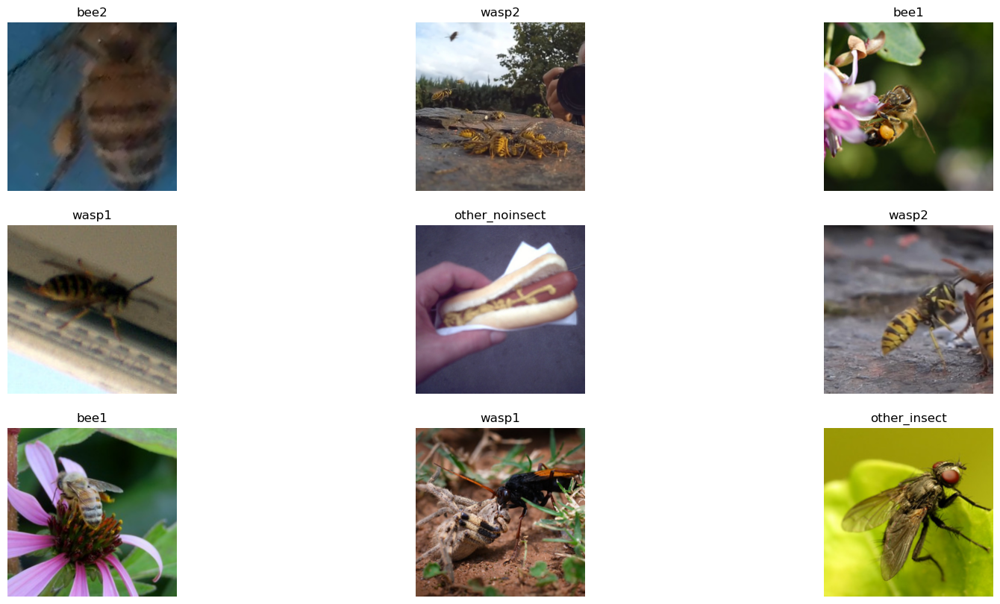

...

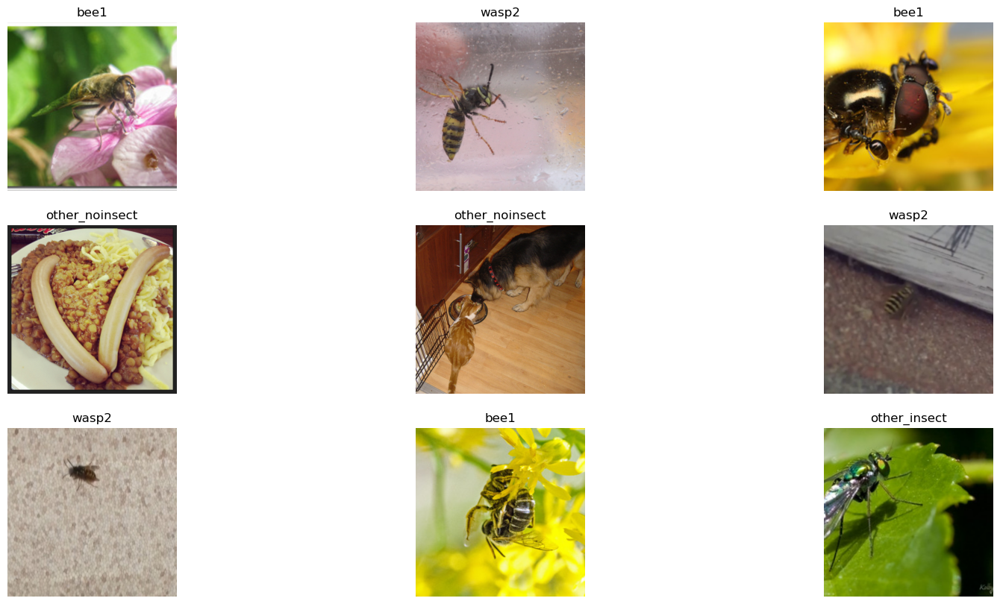

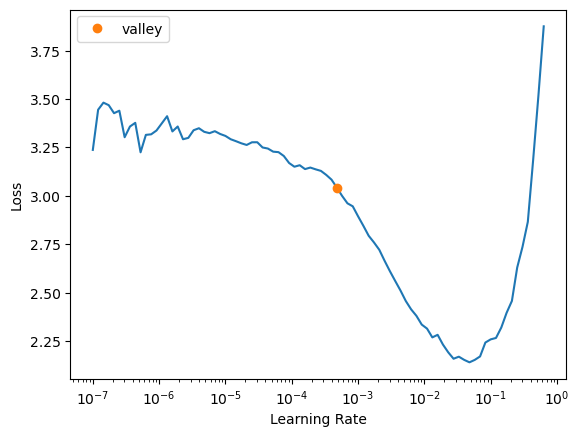

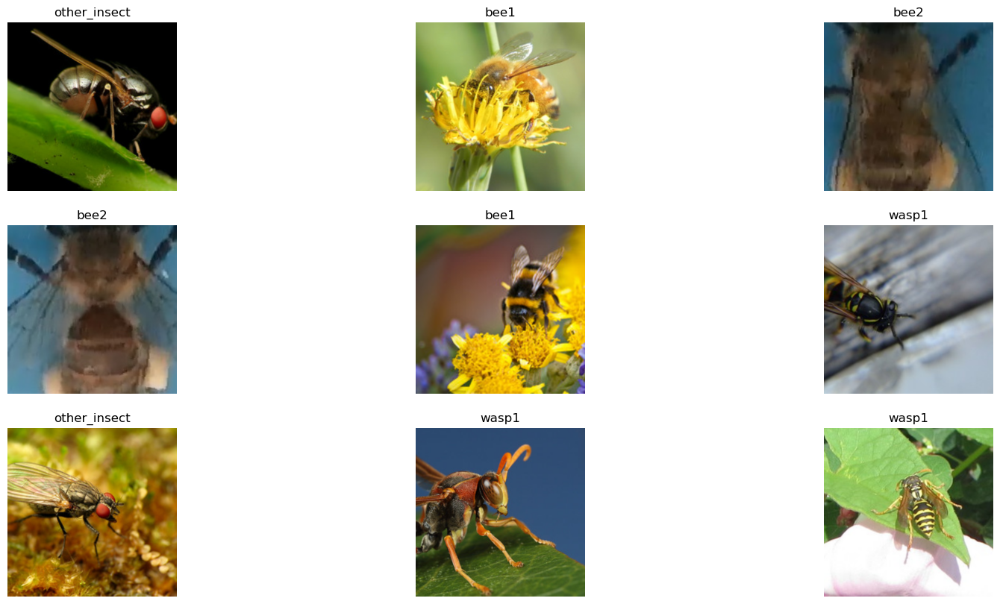

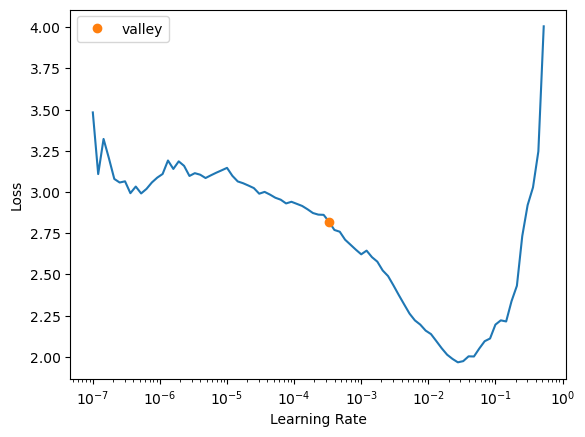

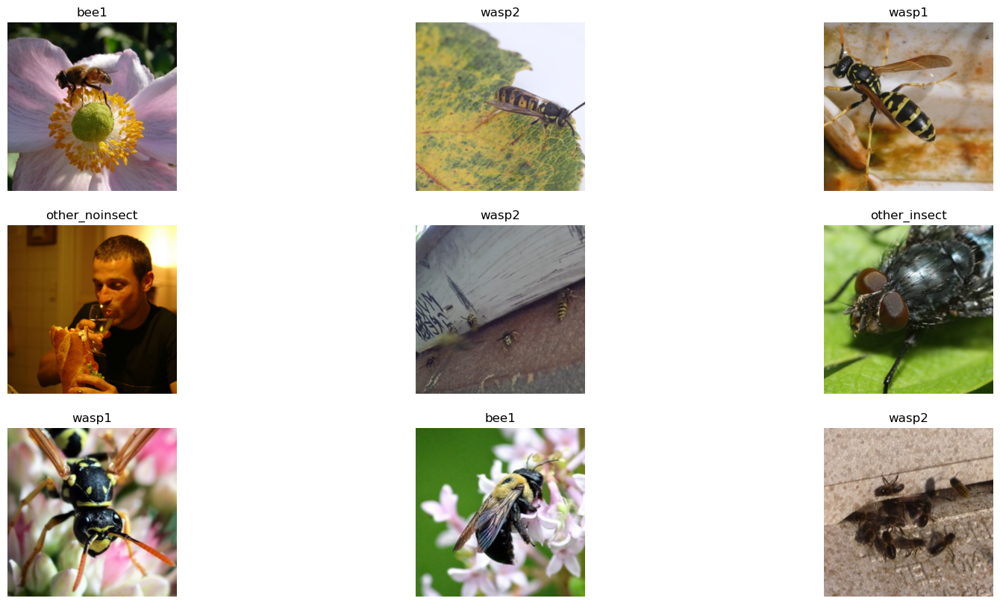

In [66]:
#image size
image_size = 224

#Image path
images_path = "/kaggle/working/images"

#test size
test_size = 0.2

#list of models to test on dataset
models = [squeezenet1_0, efficientnet_b0, resnet34]

#trial sizes of studies for each model
trial_size = 5

#Get model with the best training results
optimized_model = try_models(image_size, images_path, test_size, models, trial_size)

Try VGG16 model but run out of compute on kernel.

In [21]:
import optuna
from torchvision import transforms

#Function to train models more easily
def train_models(image_size, batch_size, images_path, test_size, model_type):
    #instructions for preparing data batches, size of images
    #and normalize data
    batch_tfms = [*aug_transforms(size=image_size),Normalize.from_stats(*imagenet_stats)]

    #function for creating batches with specified parameters
    data = ImageDataLoaders.from_folder(images_path,
                                        valid_pct=test_size,
                                        ds_tfms=batch_tfms,
                                        item_tfms=Resize(460),
                                        bs=batch_size)
    
    # test whether batch function is working with parameters
    data.show_batch(max_n=9, figsize=(20,10))

    #return the trained model
    return vision_learner(data, model_type, metrics=error_rate).to_fp16()

#function to tune automate tuning
def tune_hyperparameters(trial, image_size, images_path, test_size, model_type):
    # Define the hyperparameters to tune
    learning_rate = trial.suggest_loguniform("learning_rate", 1e-5, 1e-1)
    batch_size = trial.suggest_categorical("batch_size", [16, 32, 64])
    weight_decay = trial.suggest_loguniform("weight_decay", 1e-5, 1e-3)

    #Create model with dataset and parameters
    learn = train_models(image_size, batch_size, images_path, test_size, model_type)

    # Define the hyperparameters of the fastai learner
    learn.lr_find()

    # Fit the model with the hyperparameters
    learn.fine_tune(4, base_lr=learning_rate, wd=weight_decay)

    # Evaluate the model on the validation set
    error_rate = learn.validate()[1]
    
    # Specify the directory and file name for saving the state dictionary
    model_state_dict_file = f"/kaggle/working/{model_type.__name__}_state_dict_trial_{trial.number}.pth"

    # Save the model's state dictionary
    torch.save(learn.model.state_dict(), model_state_dict_file)

    return error_rate

#function to run trials optimizing for the tune_hyperparameters function
def optimization_study(image_size, images_path, test_size, selected_model, trial_size):

    # Create an Optuna study and optimize the tune_hyperparameters function
    study = optuna.create_study(direction="minimize") # Minimize the error rate
    study.optimize(lambda trial: tune_hyperparameters(trial, image_size, images_path, test_size, selected_model), n_trials=trial_size)

    # Print the best hyperparameters and the corresponding accuracy
    best_params = study.best_params
    best_error_rate = study.best_value
    print("\nFor Model:", selected_model.__name__)
    print("Best Trial:", study.best_trial.number)
    print("Best Hyperparameters:", best_params)
    print("Best Error Rate:", best_error_rate)
    print(f"Saved best trial's model state as {selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth")
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{selected_model.__name__}_state_dict_trial_{study.best_trial.number}.pth"

    # Get the best trial from the study
    best_trial = study.trials[study.best_trial.number]
    
    #save the model type in the trial to retrieve later
    best_trial.user_attrs['model'] = selected_model
    
    return best_trial
    
#function to try different models with the optimization_study function
def try_models(image_size, images_path, test_size, models, trial_size):
    best_trials = {}
    for model in models:
        best_trials[model.__name__] = optimization_study(image_size, images_path, test_size, model, trial_size)
        
    best_overall = min(best_trials,  key=lambda x: best_trials[x].value)
    lowest_model = best_trials[best_overall]
    print("\n\nBest Overall Model:", lowest_model.user_attrs['model'].__name__)
    print("Error Rate:", lowest_model.value)
    print("Load Model's state and retrain with best hyperparameters")
    
    
    #retrieve best model's state dict file
    best_state_dict_file = f"/kaggle/working/{lowest_model.user_attrs['model'].__name__}_state_dict_trial_{lowest_model.number}.pth"

    
    # Retrieve the hyperparameters of the best trial
    hyperparameters = lowest_model.params

    # Access individual hyperparameters
    learning_rate = hyperparameters["learning_rate"]
    batch_size = hyperparameters["batch_size"]
    weight_decay = hyperparameters["weight_decay"]

    #Create model with the same architecture as the best trial and load dict file into it
    best_model_learn = train_models(image_size, batch_size, images_path, test_size, lowest_model.user_attrs["model"])
    best_model_learn.model.load_state_dict(torch.load(best_state_dict_file))

    #unfreeze all weights to train with optimal hyperparameters
    best_model_learn.unfreeze()
    # Fit the model with the best trial's hyperparameters
    best_model_learn.fine_tune(4, base_lr=learning_rate, wd=weight_decay)

    #close it back up
    best_model_learn.freeze()
    
    # Evaluate the model on the validation set
    best_error_rate = best_model_learn.validate()[1]
    
    print(f"\n\nFinal result after training model "+lowest_model.user_attrs['model'].__name__+" with:")
    print("Hyperparameters:", hyperparameters)
    print("Error Rate:", best_error_rate)

    #return the model with all of the best results
    return best_model_learn

[I 2023-06-09 08:18:52,073] A new study created in memory with name: no-name-6fe13111-8e56-42d0-8c84-6ab8aebd7766


epoch,train_loss,valid_loss,error_rate,time
0,1.024236,0.624727,0.230736,03:08


epoch,train_loss,valid_loss,error_rate,time
0,0.772699,0.483039,0.178196,06:17
1,0.890265,0.586080,0.200963,06:21
2,0.690396,0.456631,0.162434,06:20
3,0.677583,0.447994,0.158932,06:22


[I 2023-06-09 08:48:30,904] Trial 0 finished with value: 0.158931702375412 and parameters: {'learning_rate': 0.08953917681421138, 'batch_size': 16, 'weight_decay': 0.00027206237212501824}. Best is trial 0 with value: 0.158931702375412.


epoch,train_loss,valid_loss,error_rate,time
0,2.255517,1.251019,0.458844,02:24


epoch,train_loss,valid_loss,error_rate,time


[W 2023-06-09 08:52:26,503] Trial 1 failed with parameters: {'learning_rate': 0.007207251429969567, 'batch_size': 64, 'weight_decay': 4.507556061852044e-05} because of the following error: OutOfMemoryError('CUDA out of memory. Tried to allocate 1.62 GiB (GPU 0; 15.90 GiB total capacity; 12.97 GiB already allocated; 901.75 MiB free; 14.13 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF').
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/optuna/study/_optimize.py", line 200, in _run_trial
    value_or_values = func(trial)
  File "/tmp/ipykernel_29/1742617501.py", line 55, in <lambda>
    study.optimize(lambda trial: tune_hyperparameters(trial, image_size, images_path, test_size, selected_model), n_trials=trial_size)
  File "/tmp/ipykernel_29/1742617501.py", line 37, in tune_hyperparameters
    learn.fine_t

OutOfMemoryError: CUDA out of memory. Tried to allocate 1.62 GiB (GPU 0; 15.90 GiB total capacity; 12.97 GiB already allocated; 901.75 MiB free; 14.13 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

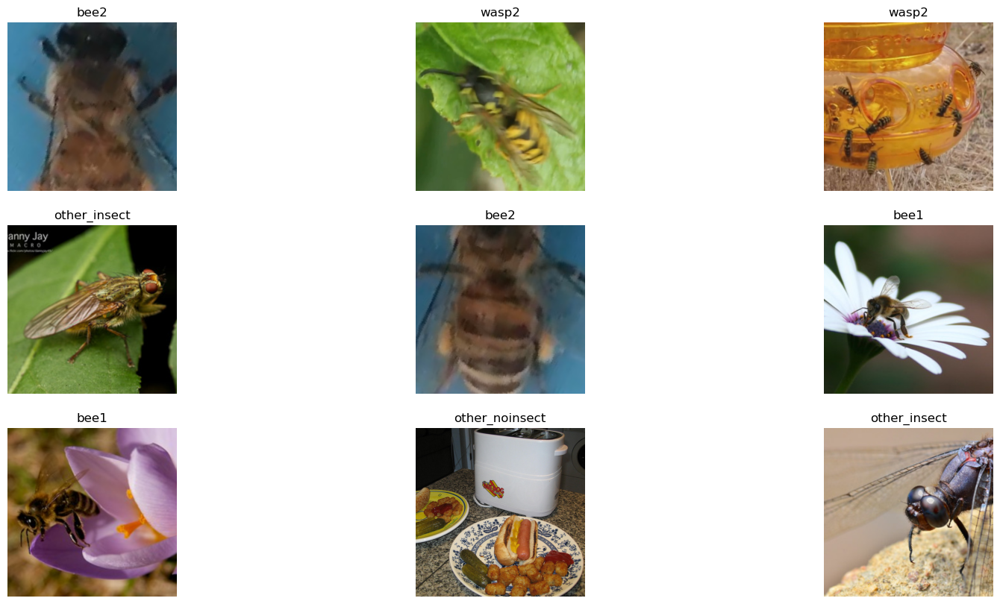

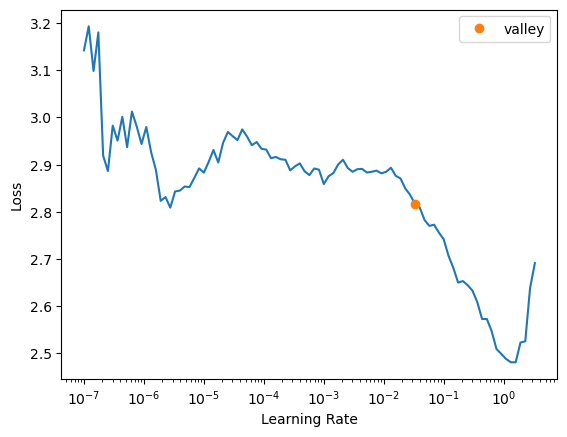

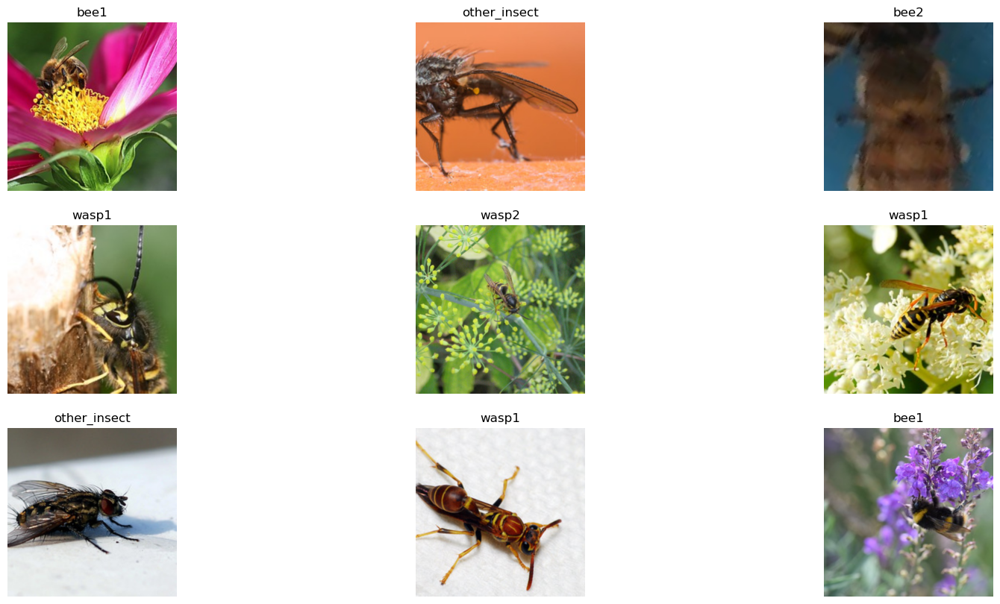

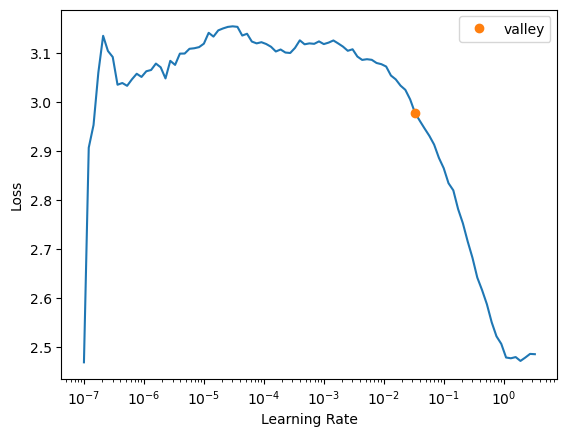

In [22]:
#image size
image_size = 224

#Image path
images_path = "/kaggle/working/images"

#test size
test_size = 0.2

#list of models to test on dataset
models = [vgg16]

#trial sizes of studies for each model
trial_size = 10

#Get model with the best training results
optimized_model = try_models(image_size, images_path, test_size, models, trial_size)

***End of Part 2 - Go to Google Colab notebook Part 3***